In [1]:
#!/usr/bin/env python
# -*- coding: utf-8 -*-
from __future__ import print_function
import argparse
import os

import numpy as np
import pickle

from keras import backend as K
from keras.callbacks import ModelCheckpoint
from keras.models import Model
from keras.layers import Input
from keras.layers import Conv2D, MaxPooling2D, UpSampling2D, Concatenate, Flatten, Dense, Dropout
from keras.layers import merge
from keras.optimizers import Adam, SGD, RMSprop
from keras.preprocessing.image import list_pictures, array_to_img

from image_ext import list_pictures_in_multidir, load_imgs_asarray
from create_fcn import create_fcn01, create_pupil_net00

np.random.seed(2016)

/home/nakazawa_atsushi/anaconda3/envs/py3/lib/python3.6/site-packages/h5py/__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters
Using TensorFlow backend.
/home/nakazawa_atsushi/anaconda3/envs/py3/lib/python3.6/importlib/_bootstrap.py:219: RuntimeWarning: compiletime version 3.5 of module 'tensorflow.python.framework.fast_tensor_util' does not match runtime version 3.6
  return f(*args, **kwds)


In [2]:
def load_fnames(paths):
    f = open(paths)
    data1 = f.read()
    f.close()
    lines = data1.split('\n')
    #print(len(lines))
    # 最終行は空行なので消す
    del(lines[len(lines)-1])
    #print(len(lines))
    return lines

In [3]:
def make_fnames(fnames,fpath,fpath_mask,mask_ext):
    fnames_img = [];
    fnames_mask= [];
    
    for i in range(len(fnames)):
        fnames_img.append(fpath + '/' + fnames[i]);
        fnames_mask.append(fpath_mask + '/' + mask_ext + fnames[i]);
        
    return [fnames_img,fnames_mask]

In [4]:
def get_center(im):
    im[im>0] = 1;
    xval = 0
    yval = 0
    npix = 0

    for x in range(0,im.shape[1]):
        xval += (x*sum(im[:,x]))
        npix += sum(im[:,x])
    
    for y in range(0,im.shape[0]):
        yval += (y*sum(im[y,:]))
    
    return [xval/npix,yval/npix]

In [5]:
#
#  MAIN STARTS FROM HERE
#
if __name__ == '__main__':
    
    target_size = (224, 224)
    dpath_this = './'
    dname_checkpoints = 'checkpoints_pupil_net00'
    dname_checkpoints_fcn01 = 'checkpoints_fcn01'
    dname_outputs = 'outputs'
    fname_architecture = 'architecture.json'
    fname_weights = "model_weights_{epoch:02d}.h5"
    fname_stats = 'stats01.npz'
    dim_ordering = 'channels_first'
    fname_history = "history.pkl"

    # definision of mode, LEARN or TEST or SHOW_HISTORY
    mode = "LEARN"
    mode = "SHOW_HISTORY"
    mode = "TEST"

    # モデルを作成
    print('creating model...')
    model_pupil_net = create_pupil_net00(target_size)

creating model...


In [6]:
#
#   LEARNING MODE
#
mode = "LEARN"
if mode == "LEARN":
    # Read Learning Data
    fnames = load_fnames('data/list_train_01.txt')
    [fpaths_xs_train,fpaths_ys_train] = make_fnames(fnames,'data/img','data/mask','OperatorA_')

    X_train = load_imgs_asarray(fpaths_xs_train, grayscale=False, target_size=target_size,
                                dim_ordering=dim_ordering)
    Y_train = load_imgs_asarray(fpaths_ys_train, grayscale=True, target_size=target_size,
                                dim_ordering=dim_ordering) 

    # Read Validation Data
    fnames = load_fnames('data/list_valid_01.txt')
    [fpaths_xs_valid,fpaths_ys_valid] = make_fnames(fnames,'data/img','data/mask','OperatorA_')

    X_valid = load_imgs_asarray(fpaths_xs_valid, grayscale=False, target_size=target_size,
                                dim_ordering=dim_ordering)
    Y_valid = load_imgs_asarray(fpaths_ys_valid, grayscale=True, target_size=target_size,
                                dim_ordering=dim_ordering)     

    # obtain center of pupil
    center_train = []
    center_valid = []
    
    for i in range(Y_train.shape[0]):
        center_train.append(get_center(Y_train[i,0,:,:]))

    for i in range(Y_valid.shape[0]):
        center_valid.append(get_center(Y_valid[i,0,:,:]))
    
    center_train = np.array(center_train)
    center_valid = np.array(center_valid)

    print('==> ' + str(len(X_train)) + ' training images loaded')
    print('==> ' + str(len(Y_train)) + ' training masks loaded')
    print('==> ' + str(len(X_valid)) + ' validation images loaded')
    print('==> ' + str(len(Y_valid)) + ' validation masks loaded')

    # 前処理
    print('computing mean and standard deviation...')
    mean = np.mean(X_train, axis=(0, 2, 3))
    std = np.std(X_train, axis=(0, 2, 3))
    print('==> mean: ' + str(mean))
    print('==> std : ' + str(std))

    print('saving mean and standard deviation to ' + fname_stats + '...')
    stats = {'mean': mean, 'std': std}
    if os.path.exists(dname_checkpoints) == 0:
        os.mkdir(dname_checkpoints)
    np.savez(dname_checkpoints + '/' + fname_stats, **stats)
    print('==> done')

    print('globally normalizing data...')
    for i in range(3):
        X_train[:, i] = (X_train[:, i] - mean[i]) / std[i]
        X_valid[:, i] = (X_valid[:, i] - mean[i]) / std[i]
    Y_train /= 255
    Y_valid /= 255
    print('==> done')

==> 1452 training images loaded
==> 1452 training masks loaded
==> 527 validation images loaded
==> 527 validation masks loaded
computing mean and standard deviation...
==> mean: [130.65465  91.2685   76.63643]
==> std : [55.2817   43.990963 43.113483]
saving mean and standard deviation to stats01.npz...
==> done
globally normalizing data...
==> done


In [7]:
    # モデルに学習済のfcn02 Weightをロードする
    epoch = 200
    fname_weights = 'model_weights_%02d.h5'%(epoch)
    model_fcn01 = create_fcn01(target_size)
    fpath_weights_fcn01 = os.path.join(dname_checkpoints_fcn01, fname_weights)
    model_fcn01.load_weights(fpath_weights_fcn01)

    # load weights from Learned U-NET
    layer_names = ['conv1_1','conv1_2','conv2_1','conv2_2']
    
    print('copying layer weights')
    for name in layer_names:
        print(name)
        model_pupil_net.get_layer(name).set_weights(model_fcn01.get_layer(name).get_weights())
        model_pupil_net.get_layer(name).trainable = True

copying layer weights
conv1_1
conv1_2
conv2_1
conv2_2


In [8]:
    # 損失関数，最適化手法を定義
    adam = Adam(lr=1e-5)
    model_pupil_net.compile(optimizer=adam, loss='mean_squared_error')

    # 構造・重みを保存するディレクトリーの有無を確認
    dpath_checkpoints = os.path.join(dpath_this, dname_checkpoints)
    if not os.path.isdir(dpath_checkpoints):
        os.mkdir(dpath_checkpoints)

    # 重みを保存するためのオブジェクトを用意
    fname_weights = "model_weights_{epoch:02d}.h5"
    fpath_weights = os.path.join(dpath_checkpoints, fname_weights)
    checkpointer = ModelCheckpoint(filepath=fpath_weights, save_best_only=False)

In [9]:
    # トレーニングを開始
    print('start training...')
    history = model_pupil_net.fit(X_train, center_train, batch_size=64, epochs=200, verbose=1,
                  shuffle=True, validation_data=(X_valid, center_valid), callbacks=[checkpointer])

start training...
Train on 1452 samples, validate on 527 samples
Epoch 1/200
1452/1452 [==============================] - 40s 28ms/step - loss: 9707.3491 - val_loss: 5031.3202
Epoch 2/200
1452/1452 [==============================] - 26s 18ms/step - loss: 1598.9953 - val_loss: 529.4722
Epoch 3/200
1452/1452 [==============================] - 26s 18ms/step - loss: 520.7719 - val_loss: 328.2873
Epoch 4/200
1452/1452 [==============================] - 26s 18ms/step - loss: 381.0917 - val_loss: 292.7188
Epoch 5/200
1452/1452 [==============================] - 26s 18ms/step - loss: 342.3565 - val_loss: 249.4367
Epoch 6/200
1452/1452 [==============================] - 26s 18ms/step - loss: 313.4960 - val_loss: 229.9896
Epoch 7/200
1452/1452 [==============================] - 26s 18ms/step - loss: 284.1325 - val_loss: 207.2639
Epoch 8/200
1452/1452 [==============================] - 26s 18ms/step - loss: 250.6473 - val_loss: 176.8624
Epoch 9/200
1452/1452 [==============================] - 26s

1452/1452 [==============================] - 26s 18ms/step - loss: 26.7172 - val_loss: 29.2079
Epoch 77/200
1452/1452 [==============================] - 26s 18ms/step - loss: 24.8709 - val_loss: 30.3150
Epoch 78/200
1452/1452 [==============================] - 26s 18ms/step - loss: 26.0585 - val_loss: 28.2292
Epoch 79/200
1452/1452 [==============================] - 26s 18ms/step - loss: 26.4649 - val_loss: 30.4127
Epoch 80/200
1452/1452 [==============================] - 26s 18ms/step - loss: 23.3545 - val_loss: 30.6167
Epoch 81/200
1452/1452 [==============================] - 26s 18ms/step - loss: 25.1991 - val_loss: 28.1108
Epoch 82/200
1452/1452 [==============================] - 26s 18ms/step - loss: 23.7374 - val_loss: 28.4808
Epoch 83/200
1452/1452 [==============================] - 26s 18ms/step - loss: 23.2115 - val_loss: 27.5193
Epoch 84/200
1452/1452 [==============================] - 26s 18ms/step - loss: 24.1530 - val_loss: 30.0649
Epoch 85/200
1452/1452 [=================

In [10]:
    # Save History
    f = open(dname_checkpoints + '/' + fname_history,'wb')
    pickle.dump(history.history,f)
    f.close

<function BufferedWriter.close>

In [11]:
#
#  TEST MODE
#
mode = "TEST"
if mode == "TEST":
    # Prediction (test) mode

    # 学習済みの重みをロード
    epoch = 200
    fname_weights = 'model_weights_%02d.h5'%(epoch)
    fpath_weights = os.path.join(dname_checkpoints, fname_weights)
    model_pupil_net.load_weights(fpath_weights)
    print('==> done')

    # Read Test Data
    fnames = load_fnames('data/list_test_01.txt')
    [fpaths_xs_test,fpaths_ys_test] = make_fnames(fnames,'data/img','data/mask','OperatorA_')

    X_test = load_imgs_asarray(fpaths_xs_test, grayscale=False, target_size=target_size,
                                dim_ordering=dim_ordering)
    Y_test = load_imgs_asarray(fpaths_ys_test, grayscale=True, target_size=target_size,
                                dim_ordering=dim_ordering)

    # Yを初期化
    center_test = []
    for i in range(Y_test.shape[0]):
        center_test.append(get_center(Y_test[i,0,:,:]))
    center_test = np.array(center_test)

    # トレーニング時に計算した平均・標準偏差をロード    
    print('loading mean and standard deviation from ' + fname_stats + '...')
    stats = np.load(dname_checkpoints + '/' + fname_stats)
    mean = stats['mean']
    std = stats['std']
    print('==> mean: ' + str(mean))
    print('==> std : ' + str(std))

    for i in range(3):
        X_test[:, i] = (X_test[:, i] - mean[i]) / std[i]
    print('==> done')

==> done
loading mean and standard deviation from stats01.npz...
==> mean: [130.65465  91.2685   76.63643]
==> std : [55.2817   43.990963 43.113483]
==> done


In [12]:
    # テストを開始
    outputs = model_pupil_net.predict(X_test)

In [13]:
    diff = outputs - center_test;
#    print(outputs)
#    print(center_test)
#    print(diff)
#
#    for i in range(diff.shape[0]):
#        print(np.linalg.norm(diff[i,:]))
    print('L2 norm av. = %f'%(np.sum(np.linalg.norm(diff,axis=1))/diff.shape[0]))

L2 norm av. = 5.327271


(111.901443,103.818268) - (111.309735,103.340708)(gt): 0.760383


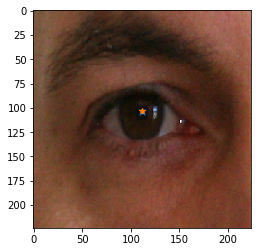

(110.616631,106.370316) - (112.974753,107.091109)(gt): 2.465823


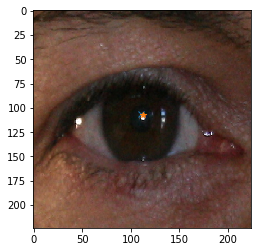

(103.616600,105.283127) - (105.842505,107.641366)(gt): 3.242830


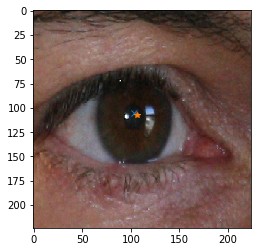

(100.276619,115.580315) - (102.058252,117.005825)(gt): 2.281731


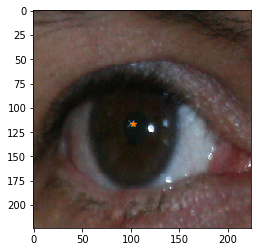

(117.892120,93.036659) - (120.073140,95.132409)(gt): 3.024733


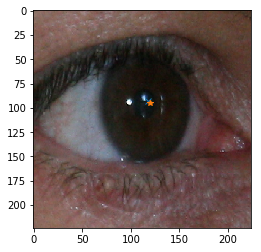

(113.953674,105.564735) - (111.545455,107.818182)(gt): 3.298112


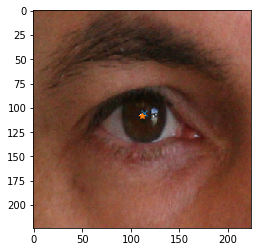

(109.605316,95.660423) - (108.933110,95.879599)(gt): 0.707035


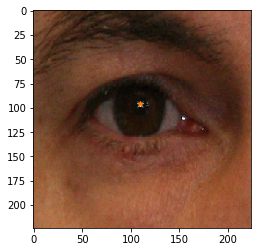

(103.335243,103.850731) - (103.211268,104.617371)(gt): 0.776600


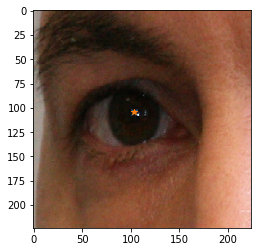

(107.041901,102.800667) - (108.445483,101.947040)(gt): 1.642778


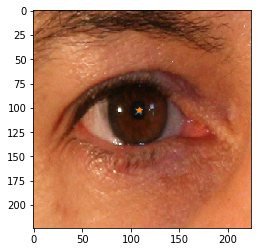

(107.994781,111.012375) - (108.952978,113.705329)(gt): 2.858346


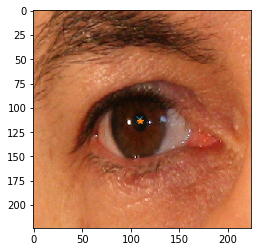

(105.194946,99.870750) - (105.860294,98.577206)(gt): 1.454629


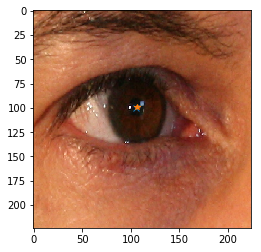

(119.412987,124.398575) - (121.791139,124.873418)(gt): 2.425095


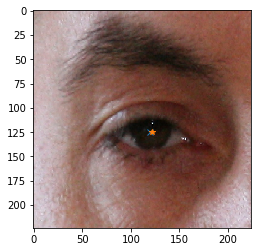

(104.976807,104.231445) - (105.961672,106.968641)(gt): 2.908986


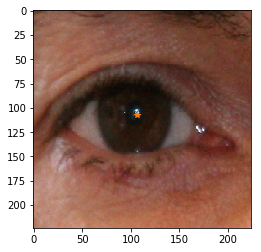

(90.236572,117.103287) - (87.907268,117.987469)(gt): 2.491473


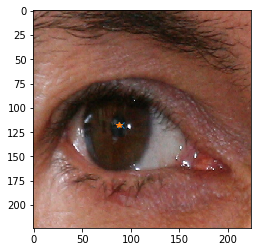

(106.655067,115.654373) - (114.317529,120.750000)(gt): 9.202104


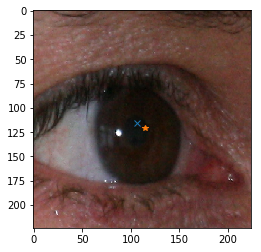

(95.166733,93.867424) - (94.922993,90.000000)(gt): 3.875097


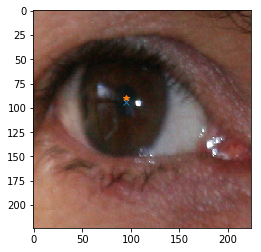

(101.340096,104.088043) - (102.000000,108.798995)(gt): 4.756947


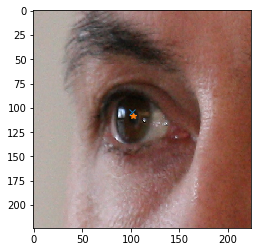

(108.495171,131.103882) - (106.497925,130.091286)(gt): 2.239272


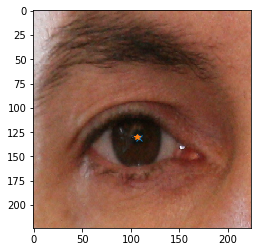

(112.356491,97.708939) - (113.913043,102.138340)(gt): 4.694939


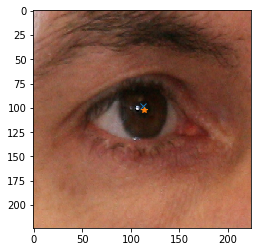

(126.978996,107.872986) - (126.479042,104.323353)(gt): 3.584668


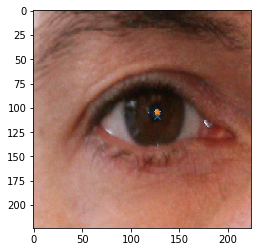

(119.291916,100.204163) - (122.997230,98.842105)(gt): 3.947727


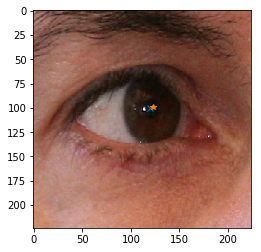

(111.291161,111.824692) - (113.861878,114.348066)(gt): 3.602223


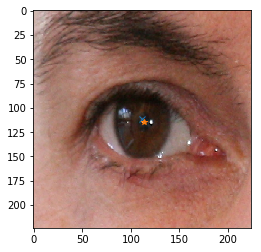

(110.367279,92.531380) - (112.614130,97.353261)(gt): 5.319669


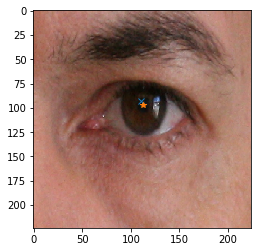

(107.598564,114.195709) - (108.570611,116.595420)(gt): 2.589109


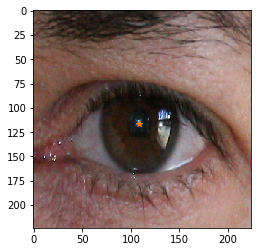

(119.781387,110.174606) - (119.943289,113.109641)(gt): 2.939497


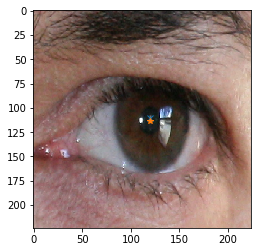

(98.706337,87.623352) - (102.921665,94.616891)(gt): 8.165695


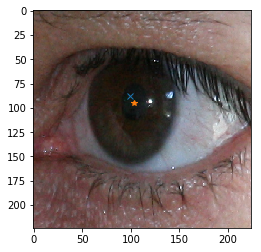

(118.151749,89.614227) - (118.401225,95.424196)(gt): 5.815322


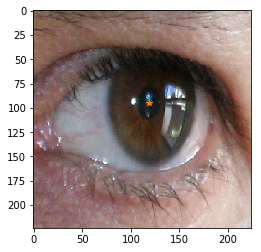

(116.199547,99.480446) - (116.422619,104.589286)(gt): 5.113708


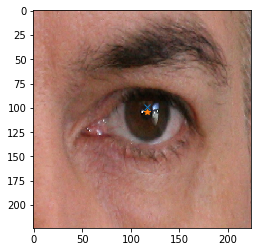

(114.275116,102.219727) - (114.238532,103.655963)(gt): 1.436703


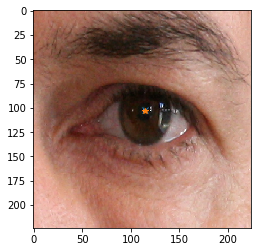

(112.930038,96.023277) - (115.235521,99.293436)(gt): 4.001149


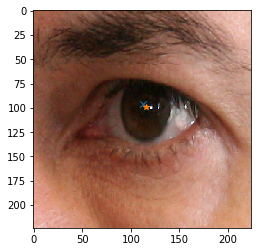

(110.694916,96.164879) - (115.996678,99.292359)(gt): 6.155470


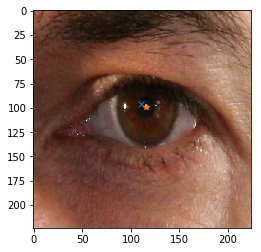

(108.696022,98.301559) - (112.587459,100.029703)(gt): 4.257906


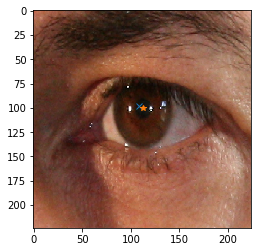

(117.103539,106.810341) - (115.992157,109.796078)(gt): 3.185875


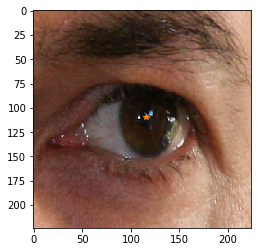

(109.241898,106.899384) - (111.972973,101.506757)(gt): 6.044766


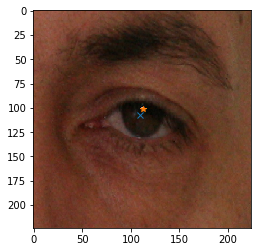

(118.264282,114.221199) - (122.140097,115.572464)(gt): 4.104614


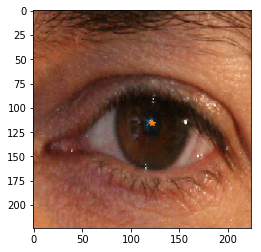

(106.554756,106.218864) - (106.988701,107.522599)(gt): 1.374056


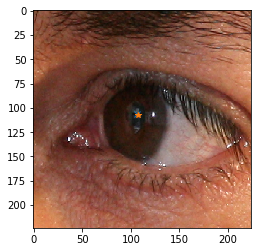

(116.731239,99.120712) - (117.615854,102.129573)(gt): 3.136206


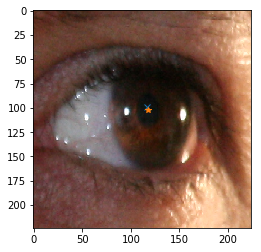

(77.550827,93.960693) - (79.950581,90.715116)(gt): 4.036408


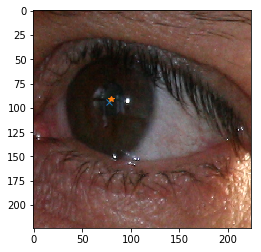

(100.728302,106.370354) - (107.520833,111.215278)(gt): 8.343367


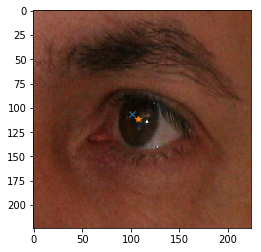

(106.833961,103.666191) - (112.250000,106.767045)(gt): 6.240895


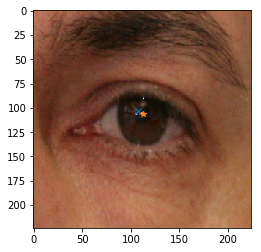

(112.288261,87.711700) - (117.200000,89.702326)(gt): 5.299789


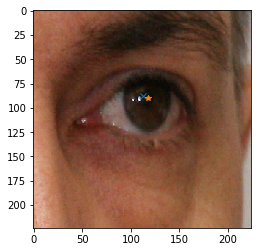

(108.025162,94.413292) - (110.382263,97.159021)(gt): 3.618695


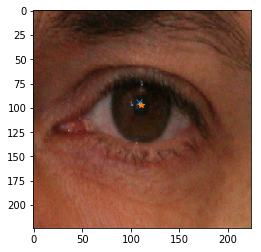

(135.031326,109.919655) - (132.092958,110.704225)(gt): 3.041309


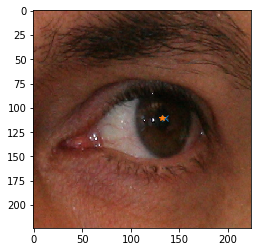

(95.517349,97.364288) - (100.672489,102.122271)(gt): 7.015259


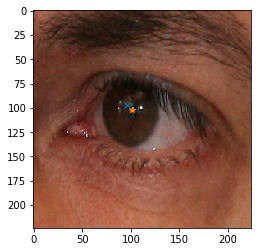

(111.680382,105.090462) - (116.065574,106.092896)(gt): 4.498309


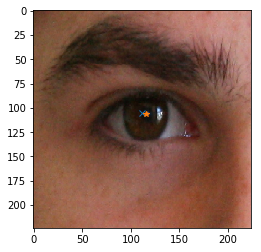

(102.659401,106.449249) - (102.483871,103.937788)(gt): 2.517588


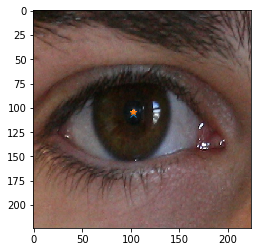

(117.829407,105.849884) - (116.876147,107.474771)(gt): 1.883869


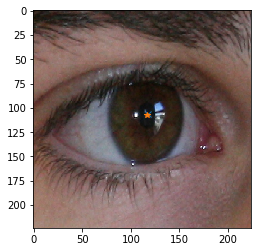

(95.320015,86.890839) - (95.938596,89.973684)(gt): 3.144293


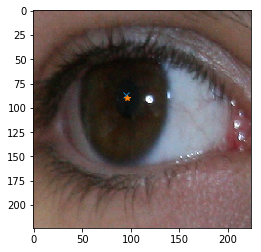

(119.690224,106.633209) - (118.081944,109.368056)(gt): 3.172688


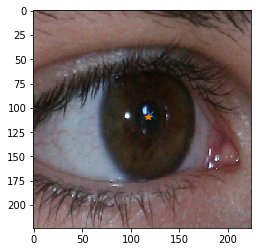

(112.128113,99.290054) - (113.155039,98.844961)(gt): 1.119234


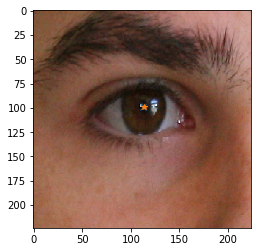

(108.787422,112.349388) - (107.191781,110.633562)(gt): 2.343103


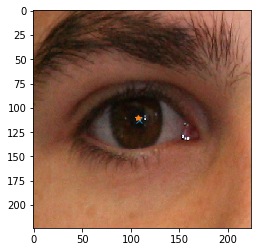

(105.361740,99.458420) - (107.056277,100.268398)(gt): 1.878169


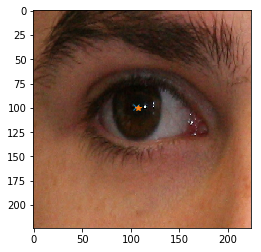

(109.429512,101.462708) - (110.036913,102.892617)(gt): 1.553569


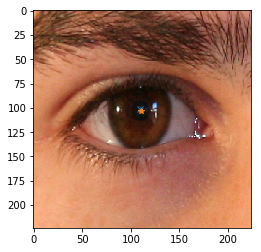

(105.185768,99.684708) - (104.120521,102.348534)(gt): 2.868924


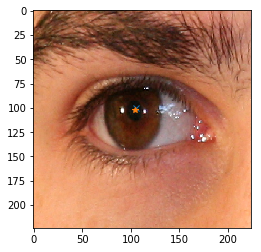

(110.176659,114.816093) - (112.830325,117.202166)(gt): 3.568653


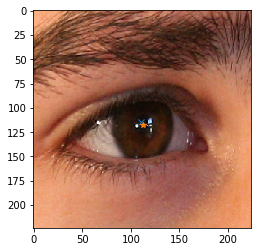

(108.246582,108.204216) - (106.272727,110.538961)(gt): 3.057309


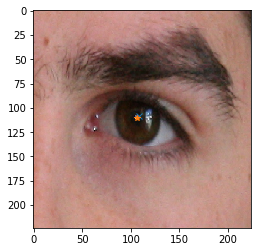

(116.879631,99.381073) - (111.787140,98.403548)(gt): 5.185463


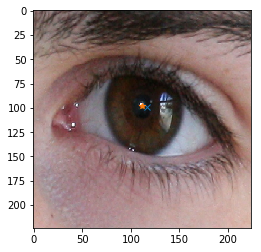

(104.286758,104.487495) - (102.147870,106.095238)(gt): 2.675758


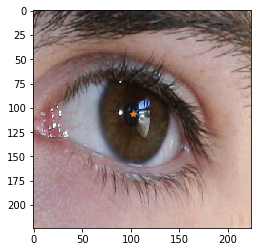

(107.396492,106.518990) - (106.883158,102.845263)(gt): 3.709417


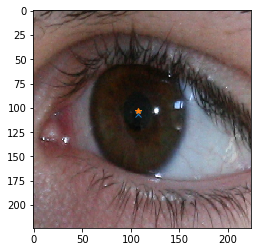

(118.235519,103.799950) - (116.605926,103.405926)(gt): 1.676553


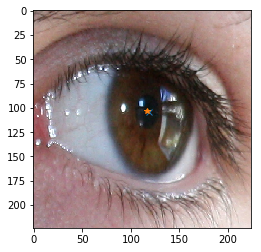

(111.562355,98.671867) - (107.443243,99.183784)(gt): 4.150800


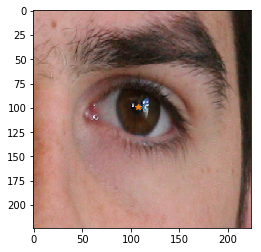

(111.140617,103.078712) - (108.008929,102.000000)(gt): 3.312264


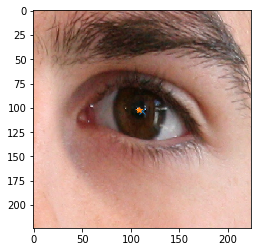

(109.972198,103.842476) - (108.628159,101.765343)(gt): 2.474050


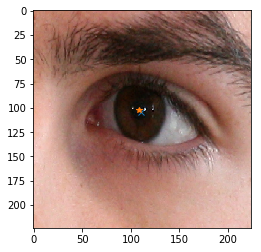

(110.576866,110.284073) - (108.701863,110.338509)(gt): 1.875793


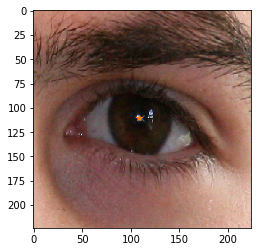

(107.024612,103.995850) - (108.462783,103.498382)(gt): 1.521778


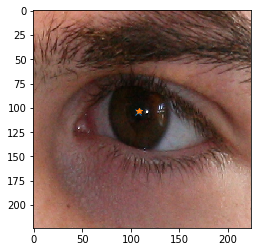

(107.838455,105.064217) - (103.164706,102.247059)(gt): 5.457134


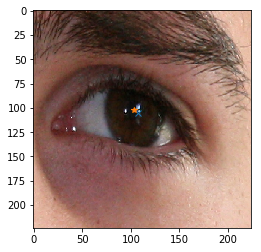

(107.634239,99.754448) - (110.988764,100.814607)(gt): 3.518064


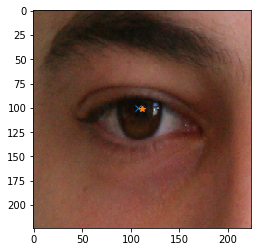

(118.313980,104.273758) - (117.012097,102.155242)(gt): 2.486566


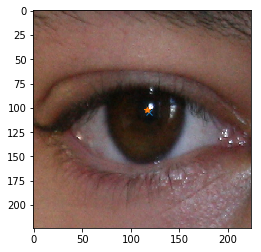

(119.770386,112.681595) - (121.339286,104.048214)(gt): 8.774777


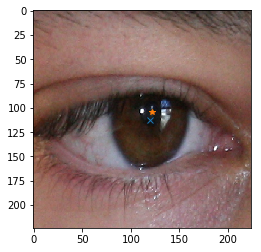

(96.096535,101.325165) - (102.694878,104.734967)(gt): 7.427306


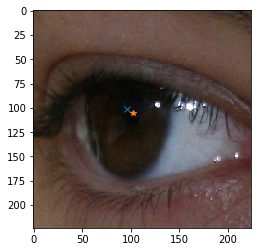

(128.060974,104.627190) - (134.161103,99.708273)(gt): 7.836282


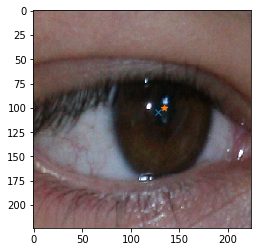

(104.381592,113.695312) - (102.916168,111.532934)(gt): 2.612154


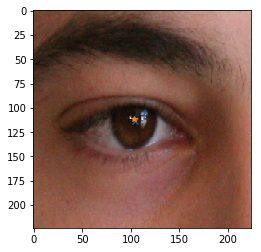

(110.697838,104.825645) - (113.694779,104.742972)(gt): 2.998081


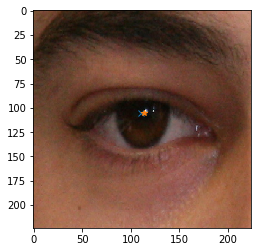

(108.295647,111.164108) - (107.085603,109.933852)(gt): 1.725612


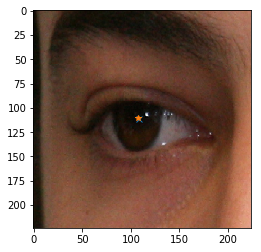

(115.712944,116.652611) - (119.680702,110.835088)(gt): 7.041781


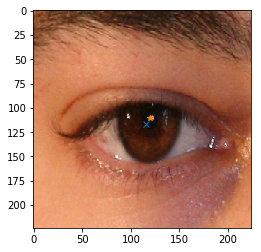

(107.110374,97.156616) - (107.185874,95.427509)(gt): 1.730754


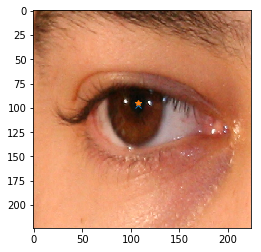

(111.113388,126.102753) - (113.196891,121.243523)(gt): 5.287069


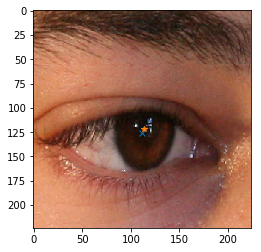

(96.706184,103.467331) - (103.472603,105.541096)(gt): 7.077070


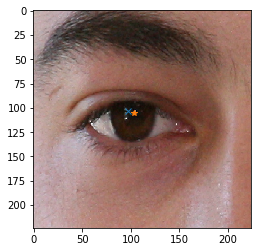

(109.693359,92.446640) - (112.351010,89.896465)(gt): 3.683273


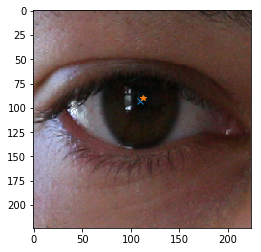

(75.271263,84.650253) - (76.375000,77.304054)(gt): 7.428653


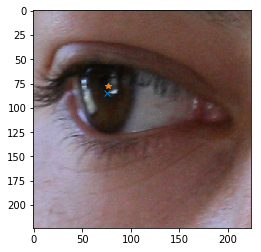

(110.716240,104.393074) - (112.689349,97.112426)(gt): 7.543275


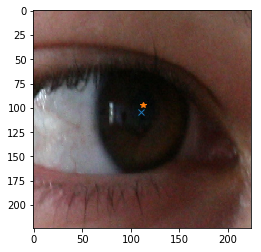

(97.482635,90.077721) - (96.862338,89.794805)(gt): 0.681770


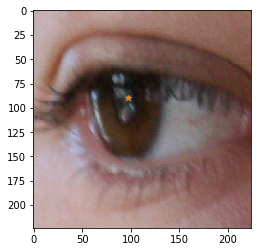

(99.282715,107.475906) - (100.307692,109.663462)(gt): 2.415777


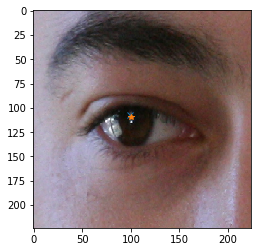

(101.913918,112.008919) - (105.084112,109.014019)(gt): 4.361142


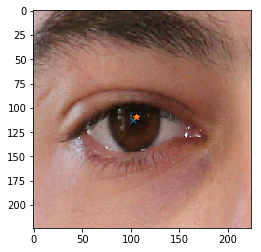

(123.575005,113.069336) - (125.202429,111.595142)(gt): 2.195850


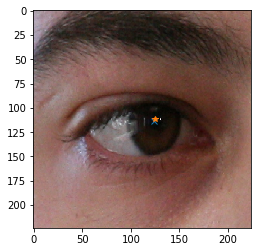

(107.599960,103.045609) - (107.670927,100.568690)(gt): 2.477935


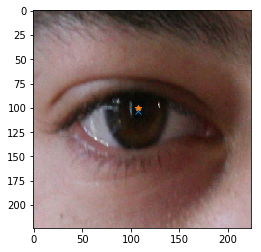

(114.642189,108.200684) - (115.314985,107.058104)(gt): 1.325950


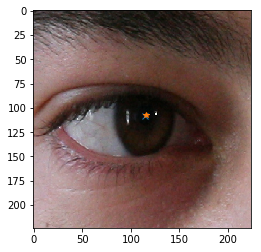

(93.213120,101.091278) - (95.422857,100.565714)(gt): 2.271378


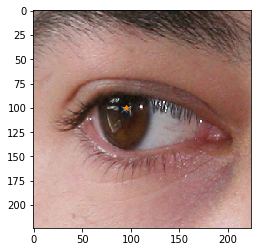

(109.795021,108.315605) - (112.767956,106.850829)(gt): 3.314198


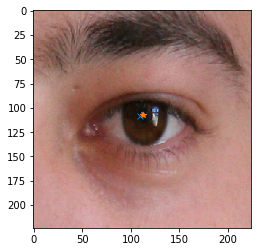

(109.556435,103.958961) - (112.320641,101.685371)(gt): 3.579113


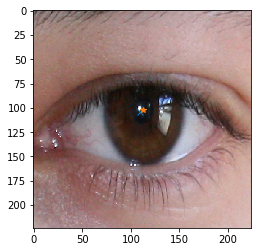

(109.903175,109.167435) - (114.792105,105.976316)(gt): 5.838225


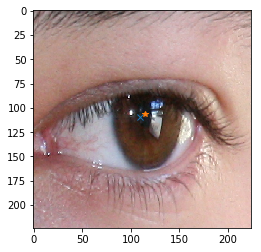

(104.708977,110.451500) - (106.175691,107.754696)(gt): 3.069853


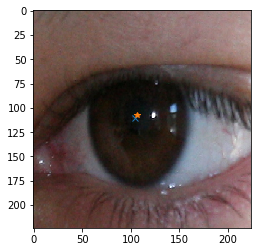

(132.073227,101.360168) - (136.312112,96.562112)(gt): 6.402304


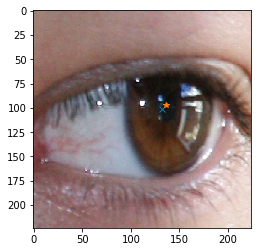

(101.873749,100.594849) - (102.202703,97.378378)(gt): 3.233248


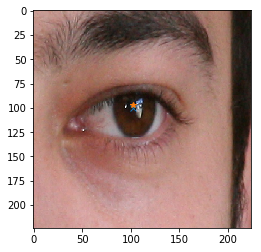

(107.271988,101.262657) - (106.601695,97.652542)(gt): 3.671814


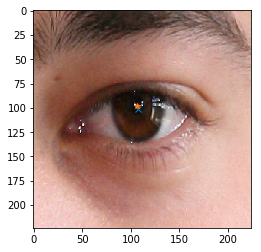

(104.965065,99.068672) - (105.928571,101.485714)(gt): 2.602006


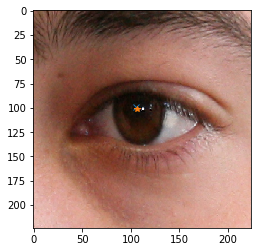

(104.828629,101.471275) - (107.470588,102.211765)(gt): 2.743770


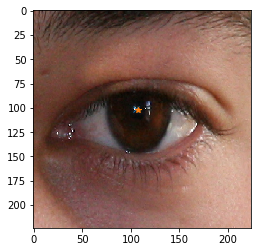

(105.411110,100.519363) - (106.821429,100.324675)(gt): 1.423693


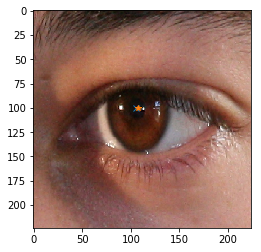

(114.671829,97.844116) - (114.920792,95.500000)(gt): 2.357300


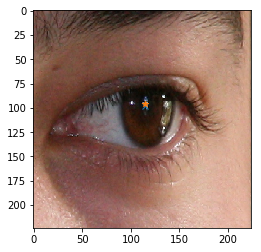

(109.515984,115.457924) - (113.432000,115.016000)(gt): 3.940873


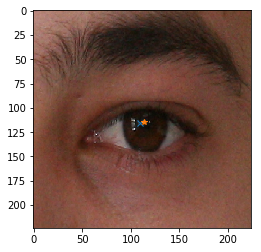

(89.214890,103.583984) - (81.404598,99.140230)(gt): 8.985968


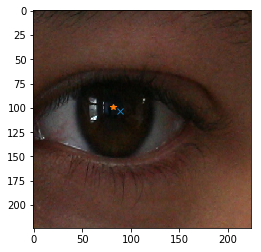

(99.794876,100.193123) - (106.671024,100.385621)(gt): 6.878842


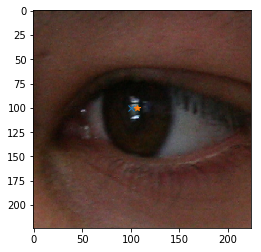

(112.658546,98.901360) - (114.815789,99.228070)(gt): 2.181843


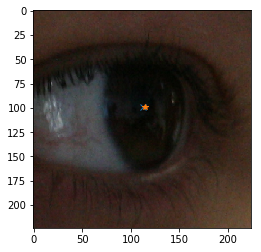

(90.242805,93.835838) - (102.059871,83.940129)(gt): 15.413244


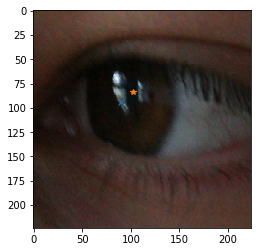

(105.789047,119.781174) - (110.030534,121.534351)(gt): 4.589536


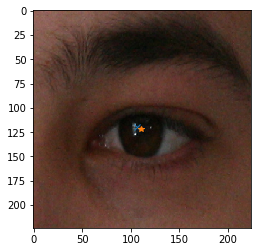

(79.929596,125.635124) - (71.130435,129.695652)(gt): 9.690878


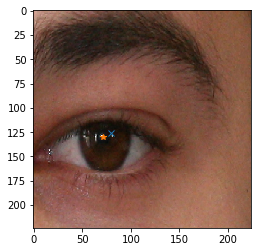

(116.869186,122.878845) - (122.349693,121.466258)(gt): 5.659625


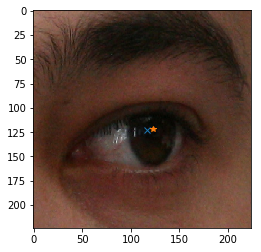

(111.645607,101.282578) - (113.976261,100.643917)(gt): 2.416575


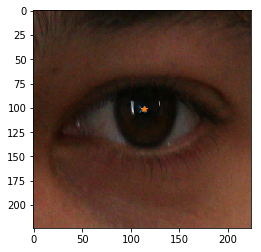

(114.169884,104.831909) - (117.853526,107.258590)(gt): 4.411122


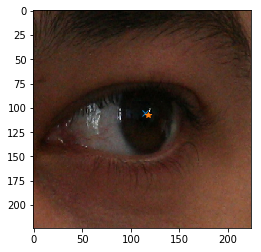

(80.912834,124.270027) - (84.121547,123.110497)(gt): 3.411795


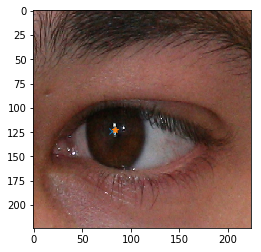

(117.959732,109.720047) - (114.251572,103.031447)(gt): 7.647733


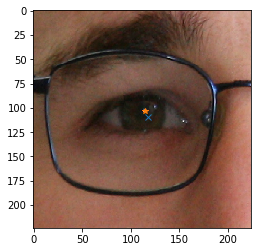

(100.879623,98.433098) - (106.514523,103.672199)(gt): 7.694171


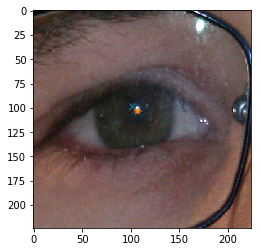

(104.115395,111.741150) - (102.507640,119.899830)(gt): 8.315584


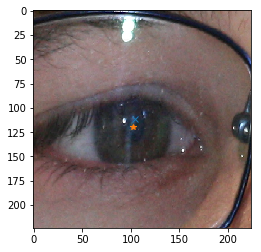

(107.170601,104.363014) - (112.951302,110.371461)(gt): 8.337742


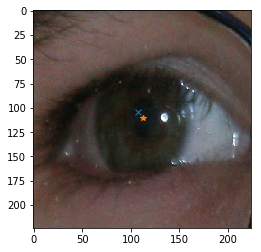

(103.017204,98.199326) - (109.185699,105.565635)(gt): 9.607957


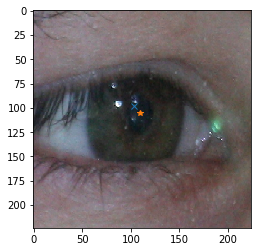

(122.219170,105.307312) - (114.110236,103.803150)(gt): 8.247260


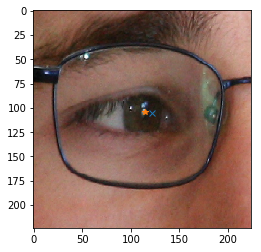

(111.889374,97.617035) - (117.399160,98.970588)(gt): 5.673610


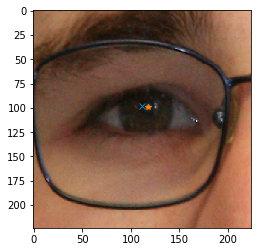

(111.144295,118.206810) - (106.376426,108.228137)(gt): 11.059227


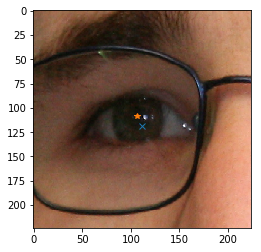

(106.179893,101.932045) - (104.241379,110.462069)(gt): 8.747522


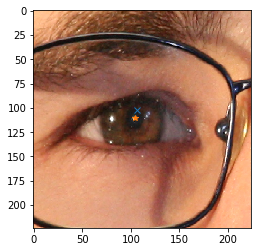

(116.665512,102.393929) - (111.865546,103.676471)(gt): 4.968359


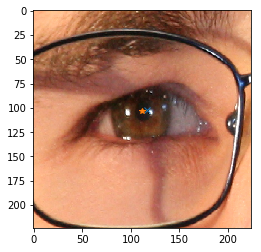

(121.495331,109.904274) - (120.265152,113.939394)(gt): 4.218475


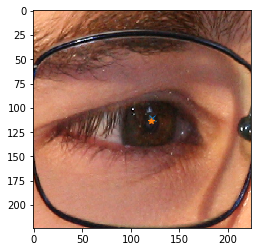

(123.838676,128.159378) - (119.036810,125.276074)(gt): 5.601015


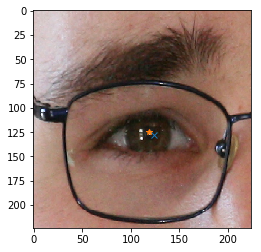

(94.983963,99.703026) - (92.002137,105.104701)(gt): 6.170039


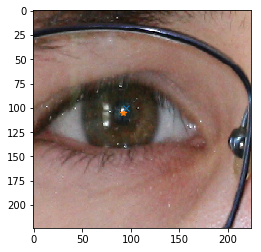

(91.325714,113.859581) - (83.927052,120.039514)(gt): 9.640113


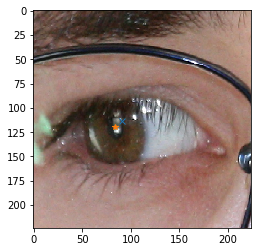

(122.414993,92.142090) - (136.448366,92.339869)(gt): 14.034766


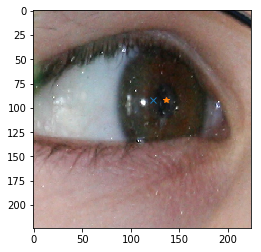

(95.294128,90.255028) - (95.004202,100.162465)(gt): 9.911678


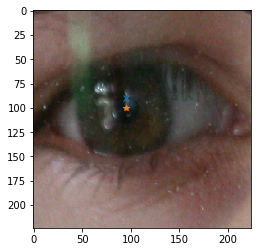

(112.693611,108.559074) - (101.137931,98.114943)(gt): 15.576060


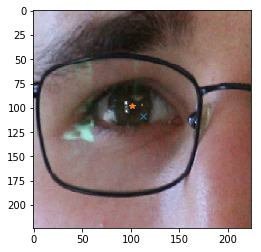

(112.910294,107.199646) - (105.086957,103.722826)(gt): 8.561126


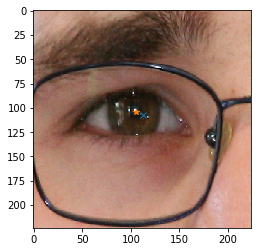

(130.845108,104.162834) - (126.721698,108.476415)(gt): 5.967369


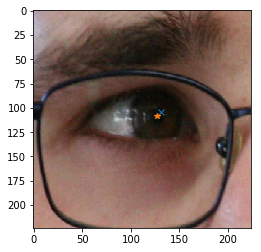

(118.978394,109.278404) - (113.634146,113.556911)(gt): 6.845918


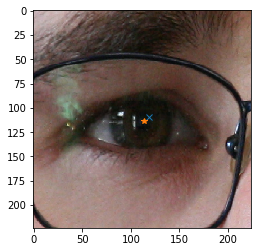

(121.726944,105.732933) - (117.893836,109.955479)(gt): 5.702860


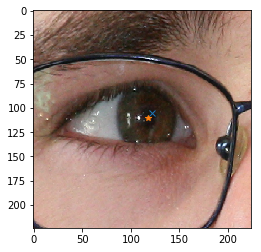

(102.081444,110.771973) - (96.370213,118.885106)(gt): 9.921749


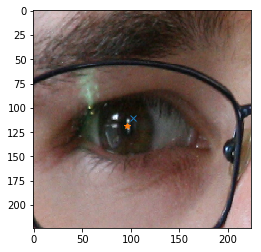

(108.479401,105.819427) - (104.073620,110.717791)(gt): 6.588238


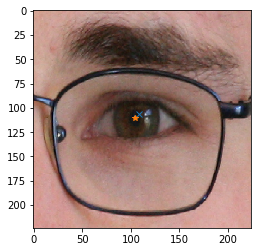

(110.949699,111.620384) - (111.754797,119.204691)(gt): 7.626919


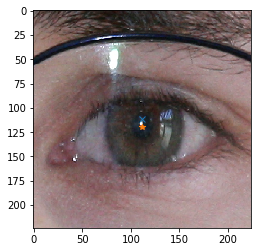

(91.826225,93.126053) - (100.650235,101.403756)(gt): 12.098905


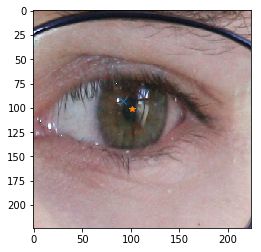

(99.040237,97.760208) - (104.551559,102.806954)(gt): 7.472905


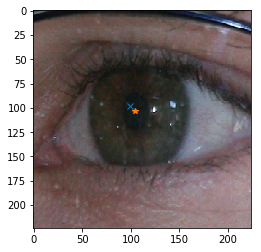

(103.595665,106.423805) - (108.163531,109.085384)(gt): 5.286719


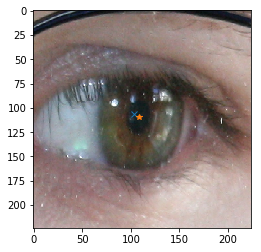

(97.646988,97.552193) - (117.465116,113.732558)(gt): 25.584418


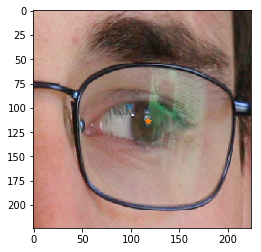

(113.898575,107.811958) - (111.442149,111.326446)(gt): 4.287850


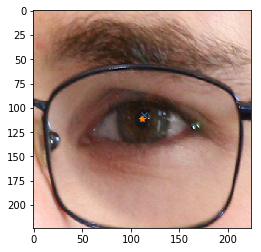

(99.559723,109.770256) - (98.814815,117.763889)(gt): 8.028266


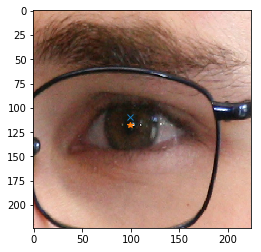

(101.928848,95.421638) - (99.285714,103.200680)(gt): 8.215817


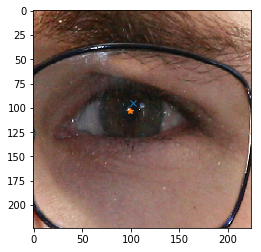

(98.916260,91.894737) - (102.051136,102.872159)(gt): 11.416271


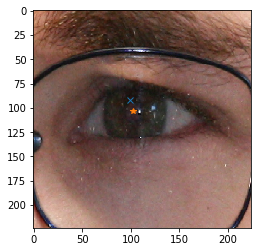

(110.595619,100.073120) - (110.427419,101.979839)(gt): 1.914123


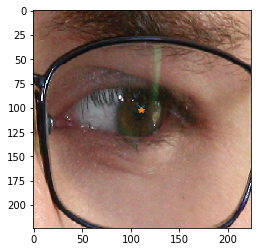

(105.561668,103.810699) - (138.255319,87.122340)(gt): 36.706622


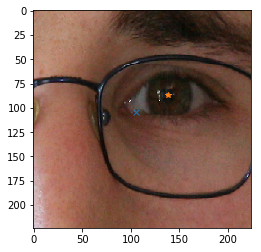

(106.462219,91.984299) - (102.744035,90.401302)(gt): 4.041136


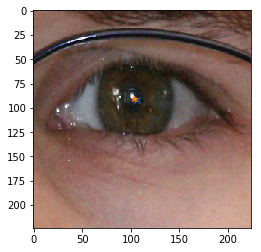

(97.891991,109.415627) - (94.543641,116.461347)(gt): 7.800873


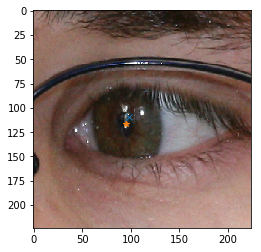

(130.594971,111.106728) - (122.009296,114.256308)(gt): 9.145144


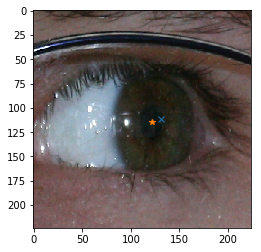

(93.995667,114.320282) - (92.004678,117.963743)(gt): 4.151968


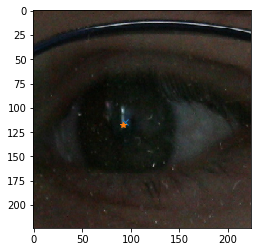

(111.896172,111.547226) - (111.767742,124.064516)(gt): 12.517949


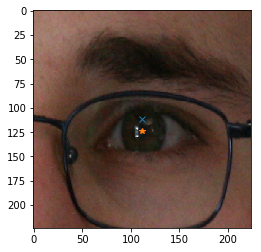

(123.110916,124.036644) - (112.315000,130.100000)(gt): 12.382088


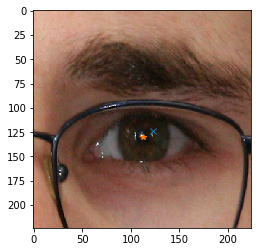

(113.426979,93.133751) - (103.838565,101.264574)(gt): 12.571713


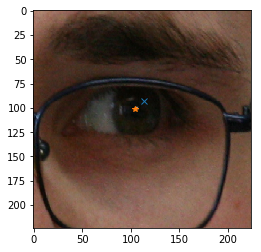

(116.454628,108.437630) - (109.091205,114.495114)(gt): 9.534837


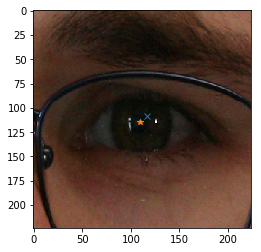

(116.581383,99.161415) - (106.748447,108.760870)(gt): 13.741767


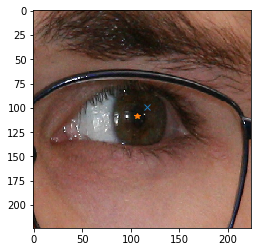

(88.469917,104.480392) - (78.333333,118.287879)(gt): 17.128836


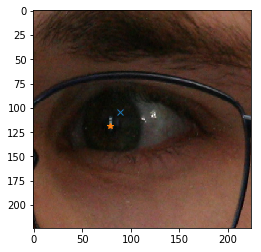

(103.321068,97.818245) - (104.675325,97.272727)(gt): 1.460000


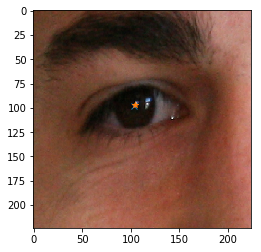

(107.418312,106.953278) - (108.099125,106.119534)(gt): 1.076400


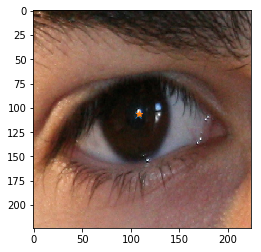

(120.546303,106.954964) - (115.779817,104.006881)(gt): 5.604515


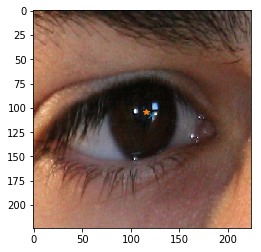

(88.334366,103.292084) - (80.674938,105.617866)(gt): 8.004755


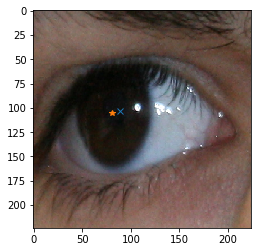

(123.655479,87.984985) - (119.827633,88.190150)(gt): 3.833340


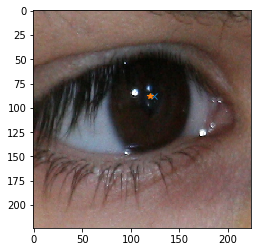

(110.713066,110.758644) - (108.471591,109.090909)(gt): 2.793842


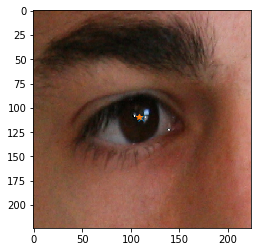

(109.844704,108.932678) - (112.920354,109.438053)(gt): 3.116894


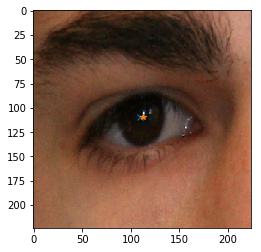

(109.353142,109.822258) - (109.100000,110.868750)(gt): 1.076674


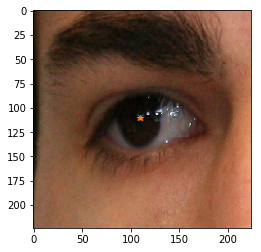

(115.286385,113.033058) - (113.323077,115.530769)(gt): 3.176970


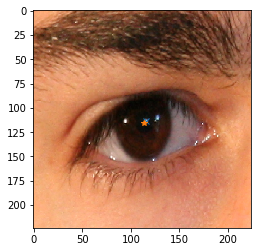

(111.693016,106.267410) - (107.872340,105.736170)(gt): 3.857432


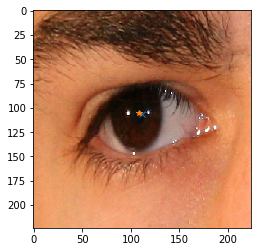

(108.600670,104.581757) - (111.210280,113.067757)(gt): 8.878191


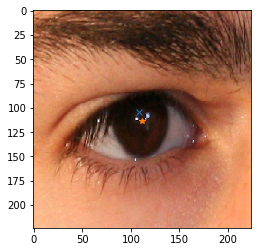

(95.836090,93.231613) - (98.471204,97.895288)(gt): 5.356649


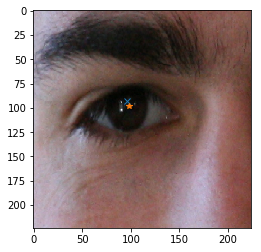

(108.824722,101.576401) - (108.948905,100.289538)(gt): 1.292841


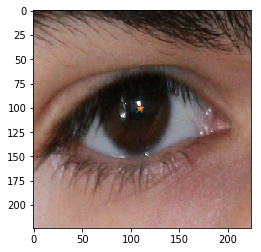

(100.065453,97.358131) - (96.532164,94.715400)(gt): 4.412274


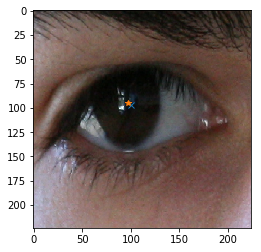

(117.784271,105.478279) - (120.727124,104.555556)(gt): 3.084121


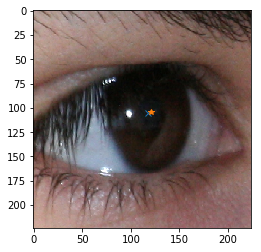

(101.070381,100.248306) - (100.225266,98.627093)(gt): 1.828265


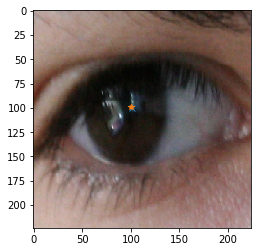

(103.473480,106.398064) - (109.167742,101.238710)(gt): 7.683980


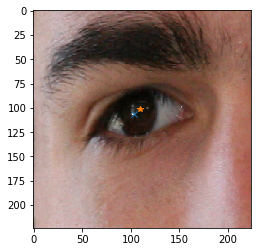

(106.207222,120.157745) - (107.528846,121.014423)(gt): 1.574988


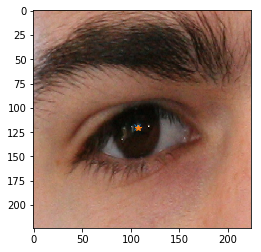

(104.054359,101.679619) - (101.856618,105.419118)(gt): 4.337502


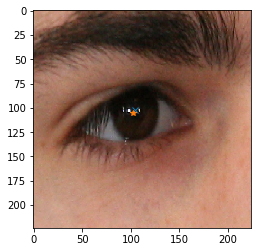

(97.442245,101.164146) - (99.530488,102.676829)(gt): 2.578559


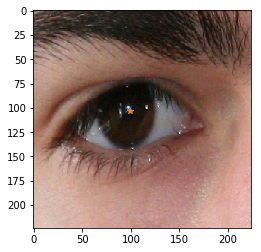

(117.792755,98.763191) - (116.844221,100.027638)(gt): 1.580678


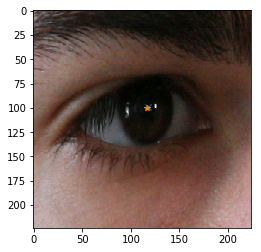

(103.607430,93.971352) - (104.529545,96.352273)(gt): 2.553250


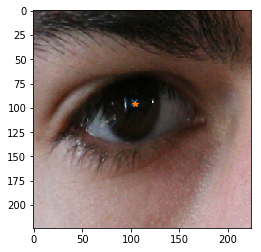

(109.653893,114.851791) - (105.654762,109.162698)(gt): 6.954051


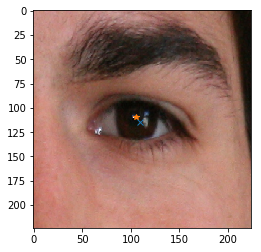

(105.170120,112.489700) - (100.354023,113.721839)(gt): 4.971213


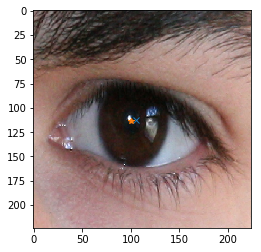

(119.077415,100.067863) - (116.238213,101.004963)(gt): 2.989853


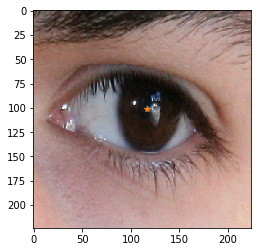

(99.404556,93.820763) - (98.321346,98.997680)(gt): 5.289028


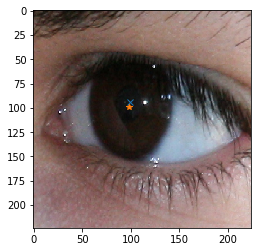

(111.607498,102.803596) - (112.308426,100.562798)(gt): 2.347867


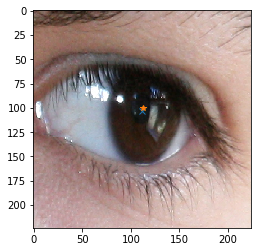

(113.341805,105.349930) - (104.056075,102.028037)(gt): 9.862036


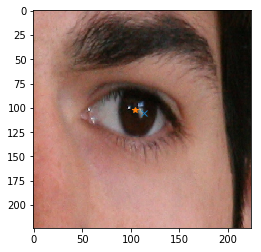

(112.173759,112.242218) - (107.355072,107.654589)(gt): 6.653276


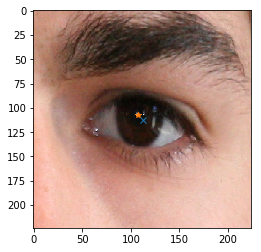

(107.854881,110.450981) - (108.246241,109.531955)(gt): 0.998885


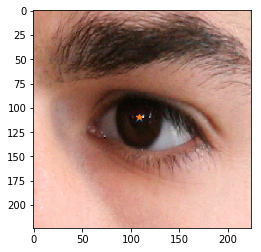

(111.905670,107.731544) - (109.595782,111.446397)(gt): 4.374439


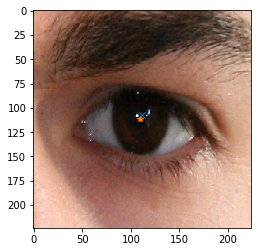

(114.753860,102.710411) - (114.296524,104.398773)(gt): 1.749206


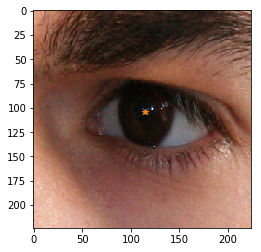

(113.673523,105.796684) - (107.373162,99.750000)(gt): 8.732522


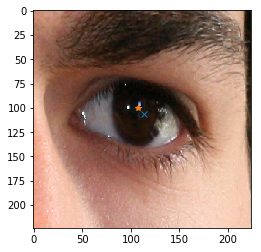

(94.746895,93.411133) - (92.473684,103.218045)(gt): 10.066927


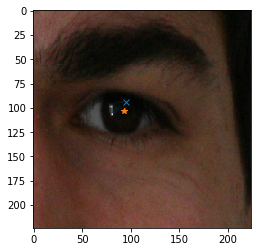

(104.978951,100.258583) - (103.021448,99.554960)(gt): 2.080121


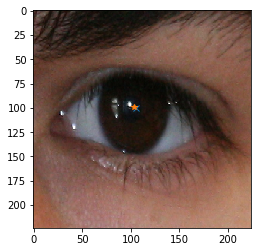

(106.618774,100.878815) - (106.552538,97.696576)(gt): 3.182928


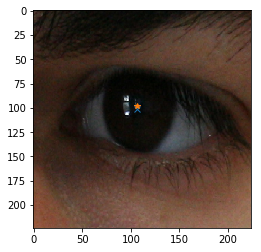

(127.444443,104.633354) - (128.354839,108.712067)(gt): 4.179081


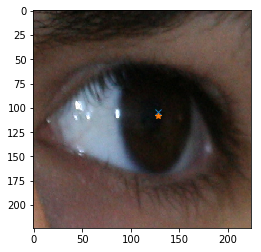

(95.888252,110.835548) - (102.814575,101.879352)(gt): 11.321987


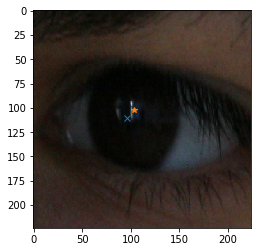

(126.690742,101.921822) - (133.346561,105.611111)(gt): 7.609913


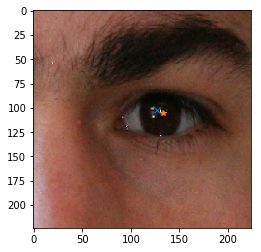

(121.235123,91.454491) - (120.732432,92.945946)(gt): 1.573892


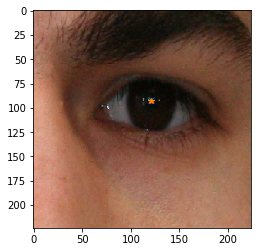

(122.083977,97.558220) - (123.638191,100.040201)(gt): 2.928449


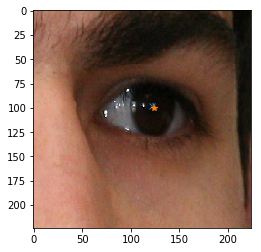

(118.448471,109.483170) - (115.053512,106.234114)(gt): 4.699161


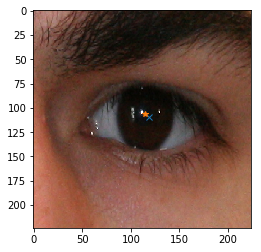

(121.236832,103.543449) - (118.018692,101.611215)(gt): 3.753659


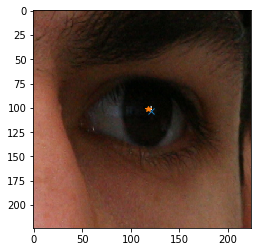

(112.700470,109.899284) - (109.877717,110.216033)(gt): 2.840469


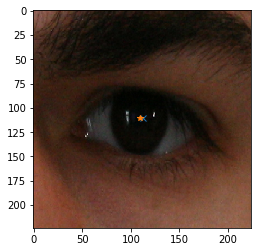

(103.075592,98.956535) - (109.220651,100.386139)(gt): 6.309161


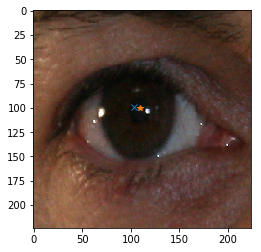

(103.618782,107.637939) - (107.280000,108.122222)(gt): 3.693108


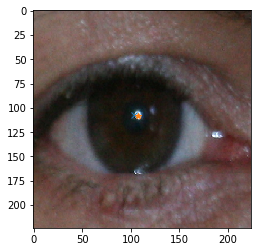

(113.156448,107.471260) - (113.256809,108.727626)(gt): 1.260369


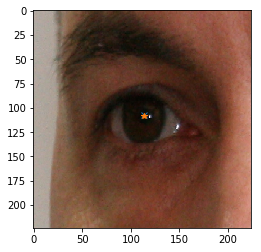

(114.500786,107.707588) - (113.320312,110.746094)(gt): 3.259760


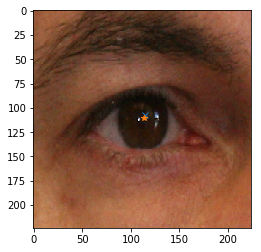

(115.453331,108.886200) - (123.029549,110.477449)(gt): 7.741521


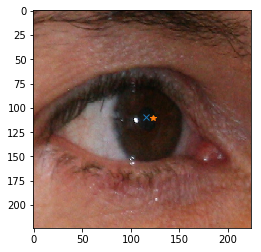

(114.591827,117.852875) - (116.800414,121.154085)(gt): 3.971881


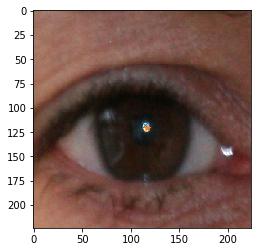

(101.846397,109.228203) - (102.196850,111.976378)(gt): 2.770430


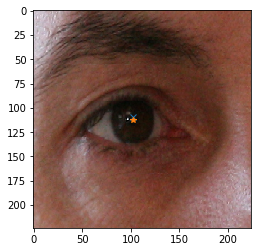

(101.624199,116.841515) - (102.422680,119.422680)(gt): 2.701849


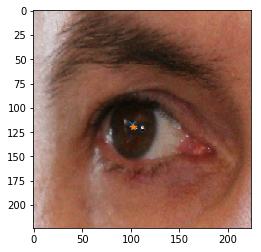

(97.070892,91.842445) - (102.506770,99.137331)(gt): 9.097479


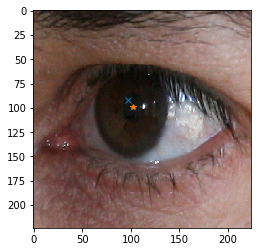

(113.671440,93.216019) - (112.284605,96.359638)(gt): 3.435935


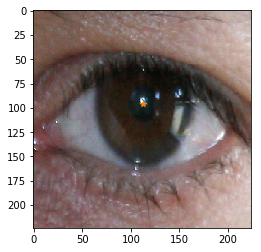

(101.798264,87.475418) - (109.356322,94.045977)(gt): 10.014814


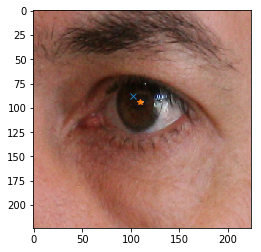

(114.530472,105.990891) - (113.557143,110.452381)(gt): 4.566428


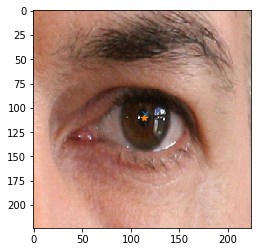

(109.409698,101.397316) - (107.529703,103.990099)(gt): 3.202641


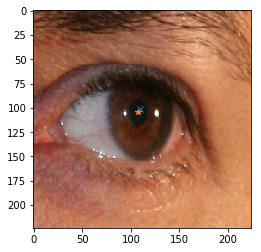

(110.697922,99.263481) - (114.056225,98.847390)(gt): 3.383982


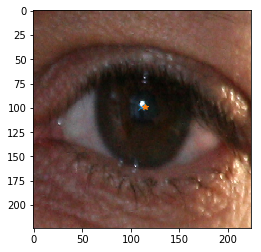

(102.663597,113.698372) - (100.804688,115.023438)(gt): 2.282837


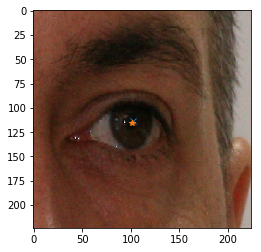

In [ ]:
from PIL import Image
import matplotlib.pyplot as plt

n = 0

for i in range(len(fpaths_xs_test)):
    # テスト画像
    im1 = Image.open(fpaths_xs_test[i])
    im1 = im1.resize(target_size) 

    # Show pupil prediction
    print('(%f,%f) - (%f,%f)(gt): %f'%(outputs[i,0],outputs[i,1],
                                       center_test[i,0],center_test[i,1],
                                       np.linalg.norm(diff[i,:])))
    plt.imshow(im1)
    plt.plot(outputs[i,0], outputs[i,1],'x')
    plt.plot(center_test[i,0], center_test[i,1], '*')
    plt.show()

    n = n + 1

In [ ]:
#
#   Show History
#
mode = 'SHOW_HISTORY'
if mode == "SHOW_HISTORY":
    # load pickle
    print(dname_checkpoints + '/' + fname_history)
    history = pickle.load(open(dname_checkpoints + '/' + fname_history, 'rb'))
    
    for k in history.keys():
        plt.plot(history[k])
        plt.title(k)
        plt.show()
